In [422]:
import numpy as np
import pandas as pd
import pandas_profiling
from sklearn.linear_model import LinearRegression

In [423]:
regional_tourism = pd.read_csv('clean_data/regional_tourism.csv')

accommodation_occupancy = pd.read_csv('clean_data/accommodation_occupancy.csv')

activities = pd.read_csv('clean_data/activities.csv')

demographics = pd.read_csv('clean_data/demographics.csv')

locations = pd.read_csv('clean_data/location.csv')

transport = pd.read_csv('clean_data/transport.csv')

international = pd.read_csv('clean_data/international.csv')

# DEMOGRAPHICS

## Prep data for modelling the predictions of total visits

* drop unnecessary columns
* set `breakdown_of_domestic_toursim` to 'Visits'

In [424]:
demographics_visits = demographics.loc[demographics.breakdown_of_domestic_tourism == 'Visits',
                                       ['year', 'value', 'age', 'marital_status', 'gender', 'employment_status',
                                       'children', 'access_to_car']]

demographics_visits['year'] = demographics_visits['year'].astype('category')

demographics_visits

,year,value,age,marital_status,gender,employment_status,children,access_to_car
0,2013,22,45-54 years,All,All,All,All,All
1,2013,58,All,All,Male,All,All,All
2,2016,23,25-34 years,All,All,All,All,All
3,2019,56,All,Not Married,All,All,All,All
4,2015,52,All,Not Married,All,All,All,All
...,...,...,...,...,...,...,...,...
302,2019,17,All,All,All,Unemployed/not working,All,All
304,2018,15,All,All,All,Unemployed/not working,All,All
305,2015,15,All,All,All,Unemployed/not working,All,All
306,2013,46,All,All,All,Unemployed/not working,All,All


### Run pandas profiling

In [366]:
pandas_profiling.ProfileReport(demographics_visits)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [425]:
demographics_visits = pd.get_dummies(demographics_visits, drop_first=True)

demographics_visits.head()

,value,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,age_25-34 years,age_35-44 years,age_45-54 years,...,marital_status_Not Married,gender_Female,gender_Male,employment_status_Employed/self-employed (full or part time),employment_status_In full or part time education,employment_status_Unemployed/not working,children_No - Children,children_Yes - Children,access_to_car_All,access_to_car_No access to car (0)
0,22,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
1,58,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,1,0
2,23,0,0,1,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,1,0
3,56,0,0,0,0,0,1,0,0,0,...,1,0,0,0,0,0,0,0,1,0
4,52,0,1,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0


### Create response and predictor variables from the independent and dependent variables

In [426]:
demographics_response = demographics_visits.value

demographics_predictor = demographics_visits.drop(columns='value')

In [427]:
demographics_response

0      22
1      58
2      23
3      56
4      52
       ..
302    17
304    15
305    15
306    46
307    11
Name: value, Length: 154, dtype: int64

In [428]:
demographics_predictor

,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,age_25-34 years,age_35-44 years,age_45-54 years,age_55-64 years,...,marital_status_Not Married,gender_Female,gender_Male,employment_status_Employed/self-employed (full or part time),employment_status_In full or part time education,employment_status_Unemployed/not working,children_No - Children,children_Yes - Children,access_to_car_All,access_to_car_No access to car (0)
0,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,1,0
2,0,0,1,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0
3,0,0,0,0,0,1,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0
4,0,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0
304,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0
305,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0
306,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0


In [429]:
model = LinearRegression()

In [430]:
model.fit(demographics_predictor, demographics_response)

LinearRegression()

### Look at the r-squared value

In [431]:
model.score(demographics_predictor, demographics_response)

0.6377919256914502

In [432]:
model.intercept_

79.73896103896115

In [433]:
pd.DataFrame(
  {
  "variable" : demographics_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year_2014,-0.454545
1,year_2015,-1.181818
2,year_2016,4.818182
3,year_2017,8.363636
4,year_2018,3.590909
5,year_2019,2.090909
6,age_25-34 years,-1.571429
7,age_35-44 years,-6.142857
8,age_45-54 years,-8.285714
9,age_55-64 years,-3.714286


In [434]:
demographics_predictor = sm.add_constant(demographics_predictor)

demographics_predictor

,const,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,age_25-34 years,age_35-44 years,age_45-54 years,...,marital_status_Not Married,gender_Female,gender_Male,employment_status_Employed/self-employed (full or part time),employment_status_In full or part time education,employment_status_Unemployed/not working,children_No - Children,children_Yes - Children,access_to_car_All,access_to_car_No access to car (0)
0,1.0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
1,1.0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,1,0
2,1.0,0,0,1,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,1,0
3,1.0,0,0,0,0,0,1,0,0,0,...,1,0,0,0,0,0,0,0,1,0
4,1.0,0,1,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302,1.0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,1,0,0,1,0
304,1.0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0
305,1.0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0
306,1.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0


In [435]:
sm_model = sm.OLS(demographics_response, demographics_predictor).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.638
Model:                            OLS   Adj. R-squared:                  0.574
Method:                 Least Squares   F-statistic:                     9.953
Date:                Tue, 11 Oct 2022   Prob (F-statistic):           4.62e-19
Time:                        15:32:47   Log-Likelihood:                -680.88
No. Observations:                 154   AIC:                             1410.
Df Residuals:                     130   BIC:                             1483.
Df Model:                          23                                         
Covariance Type:            nonrobust                                         
                                                                   coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------

# Look at k-fold

In [436]:
demographics_visits = demographics.loc[demographics.breakdown_of_domestic_tourism == 'Visits',
                                       ['year', 'value', 'age', 'marital_status', 'gender', 'employment_status',
                                       'children', 'access_to_car']]
demographics_visits

,year,value,age,marital_status,gender,employment_status,children,access_to_car
0,2013,22,45-54 years,All,All,All,All,All
1,2013,58,All,All,Male,All,All,All
2,2016,23,25-34 years,All,All,All,All,All
3,2019,56,All,Not Married,All,All,All,All
4,2015,52,All,Not Married,All,All,All,All
...,...,...,...,...,...,...,...,...
302,2019,17,All,All,All,Unemployed/not working,All,All
304,2018,15,All,All,All,Unemployed/not working,All,All
305,2015,15,All,All,All,Unemployed/not working,All,All
306,2013,46,All,All,All,Unemployed/not working,All,All


In [437]:
demographics_visits = pd.get_dummies(demographics_visits, drop_first=True)

demographics_visits.head()

,year,value,age_25-34 years,age_35-44 years,age_45-54 years,age_55-64 years,age_65 years and over,age_All,marital_status_Married,marital_status_Not Married,gender_Female,gender_Male,employment_status_Employed/self-employed (full or part time),employment_status_In full or part time education,employment_status_Unemployed/not working,children_No - Children,children_Yes - Children,access_to_car_All,access_to_car_No access to car (0)
0,2013,22,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,2013,58,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0
2,2016,23,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
3,2019,56,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0
4,2015,52,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0


In [438]:
demographics_predictors = demographics_visits.drop(columns='value')

demographics_response = demographics_visits.value

In [439]:
demo_pred_train, demo_pred_test, demo_resp_train, demo_resp_test = (
    train_test_split(
        demographics_predictors,
        demographics_response,
        test_size=0.3
    )
)

In [440]:
model = LinearRegression()
model.fit(demo_pred_train, demo_resp_train)

model.score(demo_pred_train, demo_resp_train)

0.6796999552696289

In [441]:
scores = cross_val_score(
    model, demo_pred_train, demo_resp_train, scoring='r2', cv=10
)


scores

array([0.93361706, 0.89479573, 0.61154796, 0.57984714, 0.27632888,
       0.26411372, 0.40573872, 0.86160628, 0.96415249, 0.78976437])

In [442]:
mean_score = scores.mean()
mean_score

0.6581512337396546

In [443]:
model.score(demo_pred_test, demo_resp_test)

0.5248682326534364

## Prep data, this time using a single column for all demographics

In [444]:
demographics_visits_no_all = (demographics
    .assign(demo = np.where(demographics.age != 'All', demographics.age,
                   np.where(demographics.marital_status != 'All', demographics.marital_status,
                   np.where(demographics.gender != 'All', demographics.gender,
                   np.where(demographics.employment_status != 'All', demographics.employment_status,
                   np.where(demographics.children != 'All', demographics.children,
                   np.where(demographics.access_to_car != 'All', demographics.access_to_car,
                   np.where(demographics.social_grade != 'All', demographics.social_grade, 'All')))))))
           )
)

demographics_visits_no_all = (
    demographics_visits_no_all
    .loc[(demographics_visits_no_all.breakdown_of_domestic_tourism == 'Visits') &
         (demographics_visits_no_all.demo != 'All'),
                                       ['year', 'value', 'demo']]
)

demographics_visits_no_all

,year,value,demo
0,2013,22,45-54 years
1,2013,58,Male
2,2016,23,25-34 years
3,2019,56,Not Married
4,2015,52,Not Married
...,...,...,...
302,2019,17,Unemployed/not working
304,2018,15,Unemployed/not working
305,2015,15,Unemployed/not working
306,2013,46,Unemployed/not working


In [29]:
pandas_profiling.ProfileReport(demographics_visits_no_all)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [445]:
demographics_visits_no_all = pd.get_dummies(demographics_visits_no_all, drop_first=True)

demographics_visits_no_all.head()

,year,value,demo_25-34 years,demo_35-44 years,demo_45-54 years,demo_55-64 years,demo_65 years and over,demo_AB,demo_Access to car (1+),demo_C1,...,demo_Employed/self-employed (full or part time),demo_Female,demo_In full or part time education,demo_Male,demo_Married,demo_No - Children,demo_No access to car (0),demo_Not Married,demo_Unemployed/not working,demo_Yes - Children
0,2013,22,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2013,58,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
2,2016,23,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2019,56,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,2015,52,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [446]:
response_var = demographics_visits_no_all.value

predictor_var = demographics_visits_no_all.drop(columns='value')

In [447]:
response_var

0      22
1      58
2      23
3      56
4      52
       ..
302    17
304    15
305    15
306    46
307    11
Name: value, Length: 147, dtype: int64

In [448]:
predictor_var

,year,demo_25-34 years,demo_35-44 years,demo_45-54 years,demo_55-64 years,demo_65 years and over,demo_AB,demo_Access to car (1+),demo_C1,demo_C2,...,demo_Employed/self-employed (full or part time),demo_Female,demo_In full or part time education,demo_Male,demo_Married,demo_No - Children,demo_No access to car (0),demo_Not Married,demo_Unemployed/not working,demo_Yes - Children
0,2013,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2013,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
2,2016,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2019,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,2015,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302,2019,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
304,2018,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
305,2015,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
306,2013,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0


In [449]:
model = LinearRegression()

In [450]:
model.fit(predictor_var, response_var)

LinearRegression()

In [451]:
model.score(predictor_var, response_var)

0.9658807264464464

In [452]:
model.intercept_

-1506.285714285714

In [453]:
pd.DataFrame(
  {
  "variable" : predictor_var.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year,0.760204
1,demo_25-34 years,-1.571429
2,demo_35-44 years,-6.142857
3,demo_45-54 years,-8.285714
4,demo_55-64 years,-3.714286
5,demo_65 years and over,-2.857143
6,demo_AB,18.142857
7,demo_Access to car (1+),83.428571
8,demo_C1,14.714286
9,demo_C2,-2.142857


## Attempt to look at demographics again by pulling out the values that are not equal to 'All'

In [454]:
demographics_visits = demographics.loc[demographics.breakdown_of_domestic_tourism == 'Visits',
                                       ['year', 'value', 'age', 'marital_status', 'gender', 'employment_status',
                                       'children', 'access_to_car']]
demographics_visits 

,year,value,age,marital_status,gender,employment_status,children,access_to_car
0,2013,22,45-54 years,All,All,All,All,All
1,2013,58,All,All,Male,All,All,All
2,2016,23,25-34 years,All,All,All,All,All
3,2019,56,All,Not Married,All,All,All,All
4,2015,52,All,Not Married,All,All,All,All
...,...,...,...,...,...,...,...,...
302,2019,17,All,All,All,Unemployed/not working,All,All
304,2018,15,All,All,All,Unemployed/not working,All,All
305,2015,15,All,All,All,Unemployed/not working,All,All
306,2013,46,All,All,All,Unemployed/not working,All,All


In [455]:
demographics_age = (
    demographics_visits
    .loc[demographics_visits.age != 'All', ['year', 'value', 'age']]
    .rename(columns={
        'age': 'demographic'
    })
)
demographics_age

,year,value,demographic
0,2013,22,45-54 years
2,2016,23,25-34 years
5,2015,15,45-54 years
6,2018,23,65 years and over
10,2017,34,16-24 years
11,2013,19,55-64 years
12,2015,20,65 years and over
13,2018,23,55-64 years
14,2017,31,25-34 years
16,2018,30,25-34 years


In [456]:
demographics_marital = (
    demographics_visits
    .loc[demographics_visits.marital_status != 'All', ['year', 'value', 'marital_status']]
    .rename(columns={
        'marital_status': 'demographic'
    })
)
demographics_marital

,year,value,demographic
3,2019,56,Not Married
4,2015,52,Not Married
7,2018,59,Not Married
8,2014,73,Married
15,2015,73,Married
17,2017,82,Married
28,2013,75,Married
29,2018,79,Married
33,2019,78,Married
57,2013,48,Not Married


In [457]:
demographics_gender = (
    demographics_visits
    .loc[demographics_visits.gender != 'All', ['year', 'value', 'gender']]
    .rename(columns={
        'gender': 'demographic'
    })
)
demographics_gender

,year,value,demographic
1,2013,58,Male
60,2015,62,Female
74,2014,67,Female
76,2013,66,Female
79,2016,62,Male
82,2017,73,Male
84,2017,78,Female
85,2014,61,Male
90,2018,70,Female
92,2016,80,Female


In [458]:
demographics_employment_status = (
    demographics_visits
    .loc[demographics_visits.employment_status != 'All', ['year', 'value', 'employment_status']]
    .rename(columns={
        'employment_status': 'demographic'
    })
         )
demographics_employment_status

,year,value,demographic
267,2019,14,In full or part time education
268,2016,17,In full or part time education
269,2014,11,In full or part time education
270,2018,15,In full or part time education
272,2013,13,In full or part time education
273,2017,16,In full or part time education
278,2015,14,In full or part time education
281,2017,88,Employed/self-employed (full or part time)
282,2019,74,Employed/self-employed (full or part time)
283,2018,77,Employed/self-employed (full or part time)


In [459]:
demographics_children = (
    demographics_visits
    .loc[demographics_visits.children != 'All', ['year', 'value', 'children']]
    .rename(columns={
        'children': 'demographic'
    })
)
demographics_children

,year,value,demographic
98,2017,107,No - Children
99,2018,97,No - Children
103,2013,92,No - Children
104,2016,108,No - Children
105,2015,92,No - Children
106,2014,96,No - Children
112,2013,32,Yes - Children
113,2018,41,Yes - Children
128,2019,43,Yes - Children
129,2015,32,Yes - Children


In [460]:
demographics_access_to_car = (
    demographics_visits
    .loc[demographics_visits.access_to_car != 'All', ['year', 'value', 'access_to_car']]
    .rename(columns={
        'access_to_car': 'demographic'
    })
)
demographics_access_to_car

,year,value,demographic
177,2013,24,No access to car (0)
179,2015,30,No access to car (0)
180,2017,24,No access to car (0)
181,2018,23,No access to car (0)
182,2019,110,Access to car (1+)
183,2015,95,Access to car (1+)
184,2014,101,Access to car (1+)
185,2013,100,Access to car (1+)
186,2016,22,No access to car (0)
192,2019,23,No access to car (0)


In [461]:
demographics_joined = (
    pd.concat([demographics_age,
           demographics_marital,
           demographics_gender,
           demographics_employment_status,
           demographics_access_to_car,
           demographics_children])
)

demographics_joined

,year,value,demographic
0,2013,22,45-54 years
2,2016,23,25-34 years
5,2015,15,45-54 years
6,2018,23,65 years and over
10,2017,34,16-24 years
...,...,...,...
129,2015,32,Yes - Children
136,2017,44,Yes - Children
139,2019,91,No - Children
140,2016,34,Yes - Children


In [47]:
pandas_profiling.ProfileReport(demographics_joined)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [462]:
demographics_joined = pd.get_dummies(demographics_joined, drop_first=True)

demographics_joined.head()

,year,value,demographic_25-34 years,demographic_35-44 years,demographic_45-54 years,demographic_55-64 years,demographic_65 years and over,demographic_Access to car (1+),demographic_Employed/self-employed (full or part time),demographic_Female,demographic_In full or part time education,demographic_Male,demographic_Married,demographic_No - Children,demographic_No access to car (0),demographic_Not Married,demographic_Unemployed/not working,demographic_Yes - Children
0,2013,22,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2016,23,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,2015,15,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
6,2018,23,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
10,2017,34,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [463]:
response_var = demographics_joined.value

predictor_var = demographics_joined.drop(columns='value')

In [464]:
response_var

0      22
2      23
5      15
6      23
10     34
       ..
129    32
136    44
139    91
140    34
141    31
Name: value, Length: 119, dtype: int64

In [465]:
predictor_var

,year,demographic_25-34 years,demographic_35-44 years,demographic_45-54 years,demographic_55-64 years,demographic_65 years and over,demographic_Access to car (1+),demographic_Employed/self-employed (full or part time),demographic_Female,demographic_In full or part time education,demographic_Male,demographic_Married,demographic_No - Children,demographic_No access to car (0),demographic_Not Married,demographic_Unemployed/not working,demographic_Yes - Children
0,2013,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2016,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,2015,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
6,2018,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
10,2017,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129,2015,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
136,2017,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
139,2019,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
140,2016,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [466]:
model = LinearRegression()

In [467]:
model.fit(predictor_var, response_var)

LinearRegression()

In [468]:
model.score(predictor_var, response_var)

0.9687113767085566

In [469]:
model.intercept_

-1540.7731092436984

In [470]:
pd.DataFrame(
  {
  "variable" : predictor_var.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year,0.777311
1,demographic_25-34 years,-1.571429
2,demographic_35-44 years,-6.142857
3,demographic_45-54 years,-8.285714
4,demographic_55-64 years,-3.714286
5,demographic_65 years and over,-2.857143
6,demographic_Access to car (1+),83.428571
7,demographic_Employed/self-employed (full or pa...,48.571429
8,demographic_Female,44.285714
9,demographic_In full or part time education,-12.000000


## Prep data for modelling the predictions of total expenditure

In [471]:
demographics_expenditure = demographics.loc[demographics.breakdown_of_domestic_tourism == 'Expenditure',
                                       ['year', 'value', 'age', 'marital_status', 'gender', 'employment_status',
                                       'children', 'access_to_car']]
demographics_expenditure 

,year,value,age,marital_status,gender,employment_status,children,access_to_car
36,2019,1228,All,All,All,All,All,All
37,2016,729,All,All,All,All,All,All
38,2015,1484,All,All,All,All,All,All
39,2018,637,35-44 years,All,All,All,All,All
40,2017,2033,All,All,All,All,All,All
...,...,...,...,...,...,...,...,...
296,2016,255,All,All,All,Unemployed/not working,All,All
297,2017,450,All,All,All,Unemployed/not working,All,All
298,2015,483,All,All,All,Unemployed/not working,All,All
301,2018,396,All,All,All,Unemployed/not working,All,All


In [58]:
pandas_profiling.ProfileReport(demographics_expenditure)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [472]:
demographics_expenditure = pd.get_dummies(demographics_expenditure, drop_first=True)

demographics_expenditure.head()

,year,value,age_25-34 years,age_35-44 years,age_45-54 years,age_55-64 years,age_65 years and over,age_All,marital_status_Married,marital_status_Not Married,gender_Female,gender_Male,employment_status_Employed/self-employed (full or part time),employment_status_In full or part time education,employment_status_Unemployed/not working,children_No - Children,children_Yes - Children,access_to_car_All,access_to_car_No access to car (0)
36,2019,1228,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
37,2016,729,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
38,2015,1484,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
39,2018,637,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
40,2017,2033,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0


### Create response and predictor variables from the independent and dependent variables

In [473]:
response_var = demographics_expenditure.value

predictor_var = demographics_expenditure.drop(columns='value')

In [474]:
response_var

36     1228
37      729
38     1484
39      637
40     2033
       ... 
296     255
297     450
298     483
301     396
303     715
Name: value, Length: 154, dtype: int64

In [475]:
predictor_var

,year,age_25-34 years,age_35-44 years,age_45-54 years,age_55-64 years,age_65 years and over,age_All,marital_status_Married,marital_status_Not Married,gender_Female,gender_Male,employment_status_Employed/self-employed (full or part time),employment_status_In full or part time education,employment_status_Unemployed/not working,children_No - Children,children_Yes - Children,access_to_car_All,access_to_car_No access to car (0)
36,2019,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
37,2016,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
38,2015,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
39,2018,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
40,2017,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
296,2016,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0
297,2017,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0
298,2015,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0
301,2018,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0


In [476]:
model = LinearRegression()

In [477]:
model.fit(predictor_var, response_var)

LinearRegression()

### Look at the r-squared value

In [478]:
model.score(predictor_var, response_var)

0.6428099074790754

In [479]:
model.intercept_

-154328.03376623383

In [480]:
pd.DataFrame(
  {
  "variable" : predictor_var.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year,78.077922
1,age_25-34 years,340.142857
2,age_35-44 years,131.428571
3,age_45-54 years,103.142857
4,age_55-64 years,82.142857
5,age_65 years and over,-21.000000
6,age_All,1297.657143
7,marital_status_Married,1375.342857
8,marital_status_Not Married,-353.942857
9,gender_Female,523.057143


# INTERNATIONAL DATA

## Prep data for modelling the predictions of total expenditure

In [481]:
international.nights_thousands = international.nights_thousands.replace(',','', regex=True)
international.nights_thousands = pd.to_numeric(international.nights_thousands)

international['year'] = international['year'].astype('category')

international

,year,country,purpose,mode,duration,age,visits_thousands,nights_thousands,expenditure_millions
0,2002,USA,Holiday,Air,4-7 nights,0-15,0.270000,1.600000,0.160000
1,2002,USA,Holiday,Air,4-7 nights,16-24,1.080000,4.620000,0.250000
2,2002,USA,Holiday,Air,4-7 nights,25-34,0.990000,5.030000,0.810000
3,2002,USA,Holiday,Air,4-7 nights,45-54,0.350000,1.800000,0.080000
4,2002,USA,Holiday,Air,4-7 nights,65+,1.660000,10.090000,0.620000
...,...,...,...,...,...,...,...,...,...
32044,2019,Argentina,Holiday,Air,15+ nights,65+,1.575168,14.176511,0.897375
32045,2019,Argentina,Other,Air,8-14 nights,25-34,0.631421,3.157103,0.228890
32046,2019,Rest of Latin America,Holiday,Air,8-14 nights,25-34,2.243179,11.633949,0.877631
32047,2019,Rest of Latin America,Holiday,Air,8-14 nights,45-54,0.550858,1.714171,0.135526


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

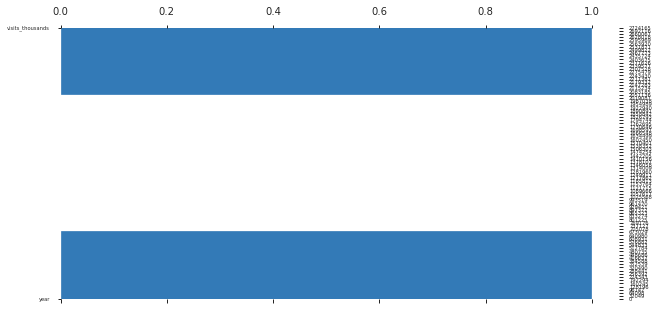

In [381]:
pandas_profiling.ProfileReport(international)

## EXPENDITURE

### Create dummy variables for categorical

In [394]:
international = pd.get_dummies(international, drop_first=True)

international

,visits_thousands,nights_thousands,expenditure_millions,visits_thousands_log,nights_thousands_log,country_Australia,country_Austria,country_Belgium,country_Brazil,country_Bulgaria,...,year_2010,year_2011,year_2012,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019
0,0.270000,1.600000,0.160000,-1.309333,0.470004,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1.080000,4.620000,0.250000,0.076961,1.530395,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0.990000,5.030000,0.810000,-0.010050,1.615420,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0.350000,1.800000,0.080000,-1.049822,0.587787,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1.660000,10.090000,0.620000,0.506818,2.311545,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32044,1.575168,14.176511,0.897375,0.454362,2.651586,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32045,0.631421,3.157103,0.228890,-0.459783,1.149655,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32046,2.243179,11.633949,0.877631,0.807894,2.453927,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32047,0.550858,1.714171,0.135526,-0.596278,0.538929,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


### Create response and predictor variables from the independent and dependent variables

In [395]:
international_response = international.expenditure_millions

international_predictor = international.drop(columns='expenditure_millions')

In [396]:
international_response

0        0.160000
1        0.250000
2        0.810000
3        0.080000
4        0.620000
           ...   
32044    0.897375
32045    0.228890
32046    0.877631
32047    0.135526
32048    0.103797
Name: expenditure_millions, Length: 32049, dtype: float64

In [397]:
international_predictor

,visits_thousands,nights_thousands,visits_thousands_log,nights_thousands_log,country_Australia,country_Austria,country_Belgium,country_Brazil,country_Bulgaria,country_C'wealth Caribbean,...,year_2010,year_2011,year_2012,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019
0,0.270000,1.600000,-1.309333,0.470004,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1.080000,4.620000,0.076961,1.530395,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0.990000,5.030000,-0.010050,1.615420,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0.350000,1.800000,-1.049822,0.587787,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1.660000,10.090000,0.506818,2.311545,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32044,1.575168,14.176511,0.454362,2.651586,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32045,0.631421,3.157103,-0.459783,1.149655,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32046,2.243179,11.633949,0.807894,2.453927,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32047,0.550858,1.714171,-0.596278,0.538929,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [398]:
model = LinearRegression()

In [399]:
model.fit(international_predictor, international_response)

LinearRegression()

### Look at the r-squared value

In [400]:
model.score(international_predictor, international_response)

0.5253598322610507

In [401]:
model.intercept_

-0.8414891425872489

In [402]:
pd.DataFrame(
  {
  "variable" : international_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,visits_thousands,0.670477
1,nights_thousands,0.026294
2,visits_thousands_log,-0.508522
3,nights_thousands_log,0.174961
4,country_Australia,0.065941
...,...,...
96,year_2015,0.283694
97,year_2016,0.355243
98,year_2017,0.379896
99,year_2018,0.224055


In [403]:
international_predictor = sm.add_constant(international_predictor)

international_predictor

,const,visits_thousands,nights_thousands,visits_thousands_log,nights_thousands_log,country_Australia,country_Austria,country_Belgium,country_Brazil,country_Bulgaria,...,year_2010,year_2011,year_2012,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019
0,1.0,0.270000,1.600000,-1.309333,0.470004,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1.0,1.080000,4.620000,0.076961,1.530395,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1.0,0.990000,5.030000,-0.010050,1.615420,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1.0,0.350000,1.800000,-1.049822,0.587787,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1.0,1.660000,10.090000,0.506818,2.311545,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32044,1.0,1.575168,14.176511,0.454362,2.651586,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32045,1.0,0.631421,3.157103,-0.459783,1.149655,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32046,1.0,2.243179,11.633949,0.807894,2.453927,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
32047,1.0,0.550858,1.714171,-0.596278,0.538929,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [404]:
sm_model = sm.OLS(international_response, international_predictor).fit()

print(sm_model.summary())

                             OLS Regression Results                             
Dep. Variable:     expenditure_millions   R-squared:                       0.525
Model:                              OLS   Adj. R-squared:                  0.524
Method:                   Least Squares   F-statistic:                     350.1
Date:                  Mon, 10 Oct 2022   Prob (F-statistic):               0.00
Time:                          19:35:50   Log-Likelihood:                -59134.
No. Observations:                 32049   AIC:                         1.185e+05
Df Residuals:                     31947   BIC:                         1.193e+05
Df Model:                           101                                         
Covariance Type:              nonrobust                                         
                                      coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------

## Look at k-fold cross validation on international data

In [127]:
international

,year,country,purpose,mode,duration,age,visits_thousands,nights_thousands,expenditure_millions
0,2002,USA,Holiday,Air,4-7 nights,0-15,0.270000,1.600000,0.160000
1,2002,USA,Holiday,Air,4-7 nights,16-24,1.080000,4.620000,0.250000
2,2002,USA,Holiday,Air,4-7 nights,25-34,0.990000,5.030000,0.810000
3,2002,USA,Holiday,Air,4-7 nights,45-54,0.350000,1.800000,0.080000
4,2002,USA,Holiday,Air,4-7 nights,65+,1.660000,10.090000,0.620000
...,...,...,...,...,...,...,...,...,...
32044,2019,Argentina,Holiday,Air,15+ nights,65+,1.575168,14.176511,0.897375
32045,2019,Argentina,Other,Air,8-14 nights,25-34,0.631421,3.157103,0.228890
32046,2019,Rest of Latin America,Holiday,Air,8-14 nights,25-34,2.243179,11.633949,0.877631
32047,2019,Rest of Latin America,Holiday,Air,8-14 nights,45-54,0.550858,1.714171,0.135526


In [128]:
pandas_profiling.ProfileReport(international)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Take logs of variables

In [129]:
international.loc[:, 'visits_thousands_log'] = (
    np.log(international.visits_thousands)
)

In [130]:
international.loc[:, 'nights_thousands_log'] = (
    np.log(international.nights_thousands)
)

In [131]:
international = pd.get_dummies(international, drop_first=True)

international.head()

,year,visits_thousands,nights_thousands,expenditure_millions,visits_thousands_log,nights_thousands_log,country_Australia,country_Austria,country_Belgium,country_Brazil,...,mode_Tunnel,duration_15+ nights,duration_4-7 nights,duration_8-14 nights,age_16-24,age_25-34,age_35-44,age_45-54,age_55-64,age_65+
0,2002,0.27,1.60,0.16,-1.309333,0.470004,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
1,2002,1.08,4.62,0.25,0.076961,1.530395,0,0,0,0,...,0,0,1,0,1,0,0,0,0,0
2,2002,0.99,5.03,0.81,-0.010050,1.615420,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
3,2002,0.35,1.80,0.08,-1.049822,0.587787,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
4,2002,1.66,10.09,0.62,0.506818,2.311545,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1


In [132]:
international_predictors = international.drop(columns='expenditure_millions')

international_response = international.expenditure_millions

In [133]:
int_pred_train, int_pred_test, int_resp_train, int_resp_test = (
    train_test_split(
        international_predictors,
        international_response,
        test_size=0.2
    )
)

In [134]:
model = LinearRegression()
model.fit(int_pred_train, int_resp_train)

model.score(int_pred_train, int_resp_train)

0.5225185744392051

In [139]:
scores = cross_val_score(
    model, int_pred_train, int_resp_train, scoring='r2', cv=10
)


scores

array([0.49323718, 0.55491711, 0.52031051, 0.64511489, 0.51033644,
       0.63209604, 0.45673213, 0.28764145, 0.51867497, 0.56678347])

In [140]:
model.score(int_pred_test, int_resp_test)

0.5331988257215716

In [138]:
pred_test = model.predict_proba(int_pred_test)

pred_test

AttributeError: 'LinearRegression' object has no attribute 'predict_proba'

## VISITS

### Create dummy variables for categorical

In [ ]:
international = pd.get_dummies(international, drop_first=True)

international

### Create response and predictor variables from the independent and dependent variables

In [ ]:
response_var = international.visits_thousands

predictor_var = international.drop(columns='visits_thousands')

In [ ]:
response_var

In [ ]:
predictor_var

In [ ]:
model = LinearRegression()

In [ ]:
model.fit(predictor_var, response_var)

### Look at the r-squared value

In [ ]:
model.score(predictor_var, response_var)

In [ ]:
model.intercept_

In [ ]:
pd.DataFrame(
  {
  "variable" : predictor_var.columns.values,
  "coefficient" : model.coef_
  }
)

## NIGHTS

### Create dummy variables for categorical

In [ ]:
international = pd.get_dummies(international, drop_first=True)

international

### Create response and predictor variables from the independent and dependent variables

In [ ]:
response_var = international.nights_thousands

predictor_var = international.drop(columns='nights_thousands')

In [ ]:
response_var

In [ ]:
predictor_var

In [ ]:
model = LinearRegression()

In [ ]:
model.fit(predictor_var, response_var)

### Look at the r-squared value

In [ ]:
model.score(predictor_var, response_var)

In [ ]:
model.intercept_

In [ ]:
pd.DataFrame(
  {
  "variable" : predictor_var.columns.values,
  "coefficient" : model.coef_
  }
)

# LOCATIONS MODEL - VISIT

## Prep data for modelling the predictions of total visits

* drop unnecessary columns
* set `breakdown_of_domestic_toursim` to 'Visits'

In [238]:
(
    locations
    .loc[(locations.breakdown_of_domestic_tourism == 'Visits') &
         (locations.type_of_location_visited != 'All areas') &
         (locations.year == 2013), :]
)

,year,units,value,type_of_location_visited,breakdown_of_domestic_tourism,location_type,is_city
56,2013,Million Visits,33,Small town,Visits,Town or Village,Not City
59,2013,Million Visits,15,Village,Visits,Town or Village,Not City
70,2013,Million Visits,59,City/large town,Visits,City,City
81,2013,Million Visits,8,Seaside resort or town,Visits,Seaside,Not City
95,2013,Million Visits,4,Seaside - beach,Visits,Seaside,Not City
100,2013,Million Visits,18,Rural countryside,Visits,Countryside,Not City
110,2013,Million Visits,3,Seaside - other,Visits,Seaside,Not City


In [339]:
locations_visits = (
    locations
    .loc[(locations.breakdown_of_domestic_tourism == 'Visits') &
         (locations.location_type != 'All'),
        ['year', 'value', 'location_type']]
)

locations_visits['year'] = locations_visits['year'].astype('category')

locations_visits

,year,value,location_type
56,2013,33,Town or Village
57,2016,17,Town or Village
58,2015,32,Town or Village
59,2013,15,Town or Village
60,2014,4,Seaside
61,2016,5,Seaside
62,2018,16,Town or Village
63,2014,12,Town or Village
64,2017,19,Town or Village
65,2017,70,City


### Run pandas profiling

In [340]:
pandas_profiling.ProfileReport(locations_visits)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [341]:
locations_visits = pd.get_dummies(locations_visits, drop_first=True)

locations_visits.head()

,value,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,location_type_Countryside,location_type_Seaside,location_type_Town or Village
56,33,0,0,0,0,0,0,0,0,1
57,17,0,0,1,0,0,0,0,0,1
58,32,0,1,0,0,0,0,0,0,1
59,15,0,0,0,0,0,0,0,0,1
60,4,1,0,0,0,0,0,0,1,0


### Create response and predictor variables from the independent and dependent variables

In [342]:
locations_response = locations_visits.value

locations_prediction = locations_visits.drop(columns='value')

In [343]:
locations_response

56     33
57     17
58     32
59     15
60      4
61      5
62     16
63     12
64     19
65     70
66      7
67     16
68     35
69     38
70     59
71     64
72     61
73     59
74      8
75     59
76      4
77      7
78      8
79      5
80      9
81      8
82     59
83      8
84     17
85     19
87     21
88     22
89     19
90      2
91      9
92      8
95      4
97      2
98      2
99     11
100    18
101    17
102    39
103    40
104    37
106     2
107     1
108     2
110     3
Name: value, dtype: int64

In [344]:
locations_prediction

,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,location_type_Countryside,location_type_Seaside,location_type_Town or Village
56,0,0,0,0,0,0,0,0,1
57,0,0,1,0,0,0,0,0,1
58,0,1,0,0,0,0,0,0,1
59,0,0,0,0,0,0,0,0,1
60,1,0,0,0,0,0,0,1,0
61,0,0,1,0,0,0,0,1,0
62,0,0,0,0,1,0,0,0,1
63,1,0,0,0,0,0,0,0,1
64,0,0,0,1,0,0,0,0,1
65,0,0,0,1,0,0,0,0,0


In [345]:
model = LinearRegression()

In [346]:
model.fit(locations_prediction, locations_response)

LinearRegression()

### Look at the r-squared value

In [347]:
model.score(locations_prediction, locations_response)

0.9043596712764661

In [348]:
model.intercept_

60.51020408163266

In [349]:
pd.DataFrame(
  {
  "variable" : locations_prediction.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year_2014,-0.142857
1,year_2015,-1.000000
2,year_2016,1.857143
3,year_2017,4.142857
4,year_2018,1.428571
5,year_2019,1.142857
6,location_type_Countryside,-42.571429
7,location_type_Seaside,-56.428571
8,location_type_Town or Village,-35.857143


In [350]:
locations_prediction = sm.add_constant(locations_prediction)

locations_prediction

,const,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,location_type_Countryside,location_type_Seaside,location_type_Town or Village
56,1.0,0,0,0,0,0,0,0,0,1
57,1.0,0,0,1,0,0,0,0,0,1
58,1.0,0,1,0,0,0,0,0,0,1
59,1.0,0,0,0,0,0,0,0,0,1
60,1.0,1,0,0,0,0,0,0,1,0
61,1.0,0,0,1,0,0,0,0,1,0
62,1.0,0,0,0,0,1,0,0,0,1
63,1.0,1,0,0,0,0,0,0,0,1
64,1.0,0,0,0,1,0,0,0,0,1
65,1.0,0,0,0,1,0,0,0,0,0


In [351]:
sm_model = sm.OLS(locations_response, locations_prediction).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.904
Model:                            OLS   Adj. R-squared:                  0.882
Method:                 Least Squares   F-statistic:                     40.98
Date:                Mon, 10 Oct 2022   Prob (F-statistic):           3.90e-17
Time:                        13:49:29   Log-Likelihood:                -158.16
No. Observations:                  49   AIC:                             336.3
Df Residuals:                      39   BIC:                             355.2
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const         

# Look at k-fold

In [177]:
locations_visits = (
    locations
    .loc[(locations.breakdown_of_domestic_tourism == 'Visits') &
         (locations.location_type != 'All'),
        ['year', 'value', 'location_type']]
)

locations_visits

,year,value,location_type
56,2013,33,Town or Village
57,2016,17,Town or Village
58,2015,32,Town or Village
59,2013,15,Town or Village
60,2014,4,Seaside
61,2016,5,Seaside
62,2018,16,Town or Village
63,2014,12,Town or Village
64,2017,19,Town or Village
65,2017,70,City


In [178]:
locations_visits = pd.get_dummies(locations_visits, drop_first=True)

locations_visits.head()

,year,value,location_type_Countryside,location_type_Seaside,location_type_Town or Village
56,2013,33,0,0,1
57,2016,17,0,0,1
58,2015,32,0,0,1
59,2013,15,0,0,1
60,2014,4,0,1,0


In [179]:
locations_predictors = locations_visits.drop(columns='value')

locations_response = locations_visits.value

In [180]:
loc_pred_train, loc_pred_test, loc_resp_train, loc_resp_test = (
    train_test_split(
        locations_predictors,
        locations_response,
        test_size=0.3
    )
)

In [181]:
model = LinearRegression()
model.fit(loc_pred_train, loc_resp_train)

model.score(loc_pred_train, loc_resp_train)

0.9180950705248362

In [182]:
scores = cross_val_score(
    model, loc_pred_train, loc_resp_train, scoring='r2', cv=10
)


scores

array([  0.96408413,   0.38511583,   0.46474817,  -0.18412297,
        -2.86705387,   0.90153302, -18.68090327,   0.96319455,
         0.98248818,   0.91494773])

In [185]:
mean_score = scores.mean()

mean_score

-1.6155968506078877

In [186]:
model.score(loc_pred_test, loc_resp_test)

0.8555336361987635

# LOCATIONS MODEL - EXPENDITURE

## Prep data for modelling the predictions of total visits

* drop unnecessary columns
* set `breakdown_of_domestic_toursim` to 'Visits'

In [352]:
locations_expenditure = (
    locations
    .loc[(locations.breakdown_of_domestic_tourism == 'Expenditure') &
         (locations.location_type != 'All'),
        ['year', 'value', 'location_type', 'is_city']]
)

locations_expenditure['year'] = locations_expenditure['year'].astype('category')

locations_expenditure

,year,value,location_type,is_city
0,2014,186,Seaside,Not City
1,2019,1456,Town or Village,Not City
4,2013,217,Seaside,Not City
5,2018,6,Seaside,Not City
6,2018,1234,Town or Village,Not City
7,2015,230,Seaside,Not City
8,2016,302,Seaside,Not City
9,2019,359,Seaside,Not City
10,2017,458,Seaside,Not City
14,2016,1037,Town or Village,Not City


### Run pandas profiling

In [353]:
pandas_profiling.ProfileReport(locations_expenditure)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [354]:
locations_expenditure = pd.get_dummies(locations_expenditure, drop_first=True)

locations_expenditure.head()

,value,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,location_type_Countryside,location_type_Seaside,location_type_Town or Village,is_city_Not City
0,186,1,0,0,0,0,0,0,1,0,1
1,1456,0,0,0,0,0,1,0,0,1,1
4,217,0,0,0,0,0,0,0,1,0,1
5,6,0,0,0,0,1,0,0,1,0,1
6,1234,0,0,0,0,1,0,0,0,1,1


### Create response and predictor variables from the independent and dependent variables

In [355]:
locations_response = locations_expenditure.value

locations_prediction = locations_expenditure.drop(columns='value')

In [356]:
locations_response

0      186
1     1456
4      217
5        6
6     1234
7      230
8      302
9      359
10     458
14    1037
15      68
16    1035
17     246
18      35
19     914
20      32
21     249
22      36
23     128
24      75
25      81
26     237
27     151
28     457
29     308
30    3400
31    3111
32    1377
33     883
34    1398
35    2873
36    2254
37    3379
38    2630
39     286
40    2850
41     206
42     778
43     520
45     429
46     402
47     228
48     502
49     482
50     510
51     651
52     483
53     612
55     545
Name: value, dtype: int64

In [357]:
locations_prediction

,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,location_type_Countryside,location_type_Seaside,location_type_Town or Village,is_city_Not City
0,1,0,0,0,0,0,0,1,0,1
1,0,0,0,0,0,1,0,0,1,1
4,0,0,0,0,0,0,0,1,0,1
5,0,0,0,0,1,0,0,1,0,1
6,0,0,0,0,1,0,0,0,1,1
7,0,1,0,0,0,0,0,1,0,1
8,0,0,1,0,0,0,0,1,0,1
9,0,0,0,0,0,1,0,1,0,1
10,0,0,0,1,0,0,0,1,0,1
14,0,0,1,0,0,0,0,0,1,1


In [358]:
model = LinearRegression()

In [359]:
model.fit(locations_prediction, locations_response)

LinearRegression()

### Look at the r-squared value

In [360]:
model.score(locations_prediction, locations_response)

0.9387345884560274

In [361]:
model.intercept_

2877.1632653061215

In [362]:
pd.DataFrame(
  {
  "variable" : locations_prediction.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year_2014,84.142857
1,year_2015,-168.428571
2,year_2016,-21.714286
3,year_2017,256.000000
4,year_2018,68.428571
5,year_2019,138.428571
6,location_type_Countryside,-589.910714
7,location_type_Seaside,-949.339286
8,location_type_Town or Village,-257.839286
9,is_city_Not City,-1797.089286


In [363]:
locations_prediction = sm.add_constant(locations_prediction)

locations_prediction

,const,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,location_type_Countryside,location_type_Seaside,location_type_Town or Village,is_city_Not City
0,1.0,1,0,0,0,0,0,0,1,0,1
1,1.0,0,0,0,0,0,1,0,0,1,1
4,1.0,0,0,0,0,0,0,0,1,0,1
5,1.0,0,0,0,0,1,0,0,1,0,1
6,1.0,0,0,0,0,1,0,0,0,1,1
7,1.0,0,1,0,0,0,0,0,1,0,1
8,1.0,0,0,1,0,0,0,0,1,0,1
9,1.0,0,0,0,0,0,1,0,1,0,1
10,1.0,0,0,0,1,0,0,0,1,0,1
14,1.0,0,0,1,0,0,0,0,0,1,1


In [364]:
sm_model = sm.OLS(locations_response, locations_prediction).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.939
Model:                            OLS   Adj. R-squared:                  0.925
Method:                 Least Squares   F-statistic:                     66.40
Date:                Mon, 10 Oct 2022   Prob (F-statistic):           7.47e-21
Time:                        13:51:32   Log-Likelihood:                -336.77
No. Observations:                  49   AIC:                             693.5
Df Residuals:                      39   BIC:                             712.5
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const         

# Look at k-fold

In [141]:
locations_expenditure = (
    locations
    .loc[(locations.breakdown_of_domestic_tourism == 'Expenditure') &
         (locations.location_type != 'All'),
        ['year', 'value', 'location_type', 'is_city']]
)

locations_expenditure

,year,value,location_type,is_city
0,2014,186,Seaside,Not City
1,2019,1456,Town or Village,Not City
4,2013,217,Seaside,Not City
5,2018,6,Seaside,Not City
6,2018,1234,Town or Village,Not City
7,2015,230,Seaside,Not City
8,2016,302,Seaside,Not City
9,2019,359,Seaside,Not City
10,2017,458,Seaside,Not City
14,2016,1037,Town or Village,Not City


In [142]:
locations_expenditure = pd.get_dummies(locations_expenditure, drop_first=True)

locations_expenditure.head()

,year,value,location_type_Countryside,location_type_Seaside,location_type_Town or Village,is_city_Not City
0,2014,186,0,1,0,1
1,2019,1456,0,0,1,1
4,2013,217,0,1,0,1
5,2018,6,0,1,0,1
6,2018,1234,0,0,1,1


In [144]:
locations_predictors = locations_expenditure.drop(columns='value')

locations_response = locations_expenditure.value

In [145]:
loc_pred_train, loc_pred_test, loc_resp_train, loc_resp_test = (
    train_test_split(
        locations_predictors,
        locations_response,
        test_size=0.3
    )
)

In [146]:
model = LinearRegression()
model.fit(loc_pred_train, loc_resp_train)

model.score(loc_pred_train, loc_resp_train)

0.9276129514989955

In [147]:
scores = cross_val_score(
    model, loc_pred_train, loc_resp_train, scoring='r2', cv=10
)


scores

array([  0.92826177,  -0.48872121,   0.93200971,   0.757339  ,
       -36.05780924,   0.97039834,   0.74919746,   0.90353369,
         0.30460012,  -5.89113912])

In [149]:
model.score(loc_pred_test, loc_resp_test)

0.890486156154486

In [ ]:
#

# TRANSPORT MODEL - VISIT

## Prep data for modelling the predictions of total visits

* drop unnecessary columns
* set `breakdown_of_domestic_toursim` to 'Visits'
* convert `year` to category

In [265]:
transport_visits = (
    transport
    .loc[(transport.breakdown_of_domestic_tourism == 'Visits') &
         (transport.transport_type != 'All'),
        ['year', 'value', 'transport_type']]
)

transport_visits['year'] = transport_visits['year'].astype('category')

transport_visits

,year,value,transport_type
118,2015,0.6,Other
119,2018,2.0,Other
120,2014,1.0,Other
121,2014,0.2,Other
122,2014,0.6,Boat
...,...,...,...
231,2018,12.2,Bus
232,2018,84.2,Car
233,2013,79.7,Car
234,2016,0.2,Rail


### Run pandas profiling

In [266]:
pandas_profiling.ProfileReport(transport_visits)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [267]:
transport_visits = pd.get_dummies(transport_visits, drop_first=True)

transport_visits.head()

,value,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,transport_type_Bus,transport_type_Car,transport_type_Other,transport_type_Plane,transport_type_Rail
118,0.6,0,1,0,0,0,0,0,0,1,0,0
119,2.0,0,0,0,0,1,0,0,0,1,0,0
120,1.0,1,0,0,0,0,0,0,0,1,0,0
121,0.2,1,0,0,0,0,0,0,0,1,0,0
122,0.6,1,0,0,0,0,0,0,0,0,0,0


### Create response and predictor variables from the independent and dependent variables

In [268]:
transport_response = transport_visits.value

transport_predictor = transport_visits.drop(columns='value')

In [269]:
transport_response

118     0.6
119     2.0
120     1.0
121     0.2
122     0.6
       ... 
231    12.2
232    84.2
233    79.7
234     0.2
235     0.2
Name: value, Length: 111, dtype: float64

In [270]:
transport_predictor

,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,transport_type_Bus,transport_type_Car,transport_type_Other,transport_type_Plane,transport_type_Rail
118,0,1,0,0,0,0,0,0,1,0,0
119,0,0,0,0,1,0,0,0,1,0,0
120,1,0,0,0,0,0,0,0,1,0,0
121,1,0,0,0,0,0,0,0,1,0,0
122,1,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
231,0,0,0,0,1,0,1,0,0,0,0
232,0,0,0,0,1,0,0,1,0,0,0
233,0,0,0,0,0,0,0,1,0,0,0
234,0,0,1,0,0,0,0,0,0,0,1


In [271]:
model = LinearRegression()

In [272]:
model.fit(transport_predictor, transport_response)

LinearRegression()

### Look at the r-squared value

In [273]:
model.score(transport_predictor, transport_response)

0.29232065694493525

In [274]:
model.intercept_

-0.31903011204481935

In [275]:
pd.DataFrame(
  {
  "variable" : transport_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year_2014,0.211765
1,year_2015,0.017647
2,year_2016,1.382616
3,year_2017,1.995950
4,year_2018,1.095950
5,year_2019,0.829283
6,transport_type_Bus,12.457143
7,transport_type_Car,29.680952
8,transport_type_Other,1.588653
9,transport_type_Plane,0.542857


In [276]:
transport_predictor = sm.add_constant(transport_predictor)

transport_predictor

,const,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,transport_type_Bus,transport_type_Car,transport_type_Other,transport_type_Plane,transport_type_Rail
118,1.0,0,1,0,0,0,0,0,0,1,0,0
119,1.0,0,0,0,0,1,0,0,0,1,0,0
120,1.0,1,0,0,0,0,0,0,0,1,0,0
121,1.0,1,0,0,0,0,0,0,0,1,0,0
122,1.0,1,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
231,1.0,0,0,0,0,1,0,1,0,0,0,0
232,1.0,0,0,0,0,1,0,0,1,0,0,0
233,1.0,0,0,0,0,0,0,0,1,0,0,0
234,1.0,0,0,1,0,0,0,0,0,0,0,1


In [277]:
sm_model = sm.OLS(transport_response, transport_predictor).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.292
Model:                            OLS   Adj. R-squared:                  0.214
Method:                 Least Squares   F-statistic:                     3.718
Date:                Mon, 10 Oct 2022   Prob (F-statistic):           0.000188
Time:                        12:30:42   Log-Likelihood:                -471.53
No. Observations:                 111   AIC:                             967.1
Df Residuals:                      99   BIC:                             999.6
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.3190 

# TRANSPORT MODEL - EXPENDITURE

## Prep data for modelling the predictions of total visits

* drop unnecessary columns
* set `breakdown_of_domestic_toursim` to 'Expenditure'

In [278]:
transport_expenditure = (
    transport
    .loc[(transport.breakdown_of_domestic_tourism == 'Expenditure') &
         (transport.transport_type != 'All'),
        ['year', 'value', 'transport_type']]
)

transport_expenditure['year'] = transport_expenditure['year'].astype('category')

transport_expenditure

,year,value,transport_type
0,2018,251.8,Other
1,2018,1.8,Other
2,2014,97.8,Other
3,2017,168.8,Other
4,2018,193.1,Plane
...,...,...,...
111,2017,10.1,Rail
112,2014,4.4,Rail
113,2015,7.9,Other
114,2016,5.7,Rail


### Run pandas profiling

In [279]:
pandas_profiling.ProfileReport(transport_expenditure)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [280]:
transport_expenditure = pd.get_dummies(transport_expenditure, drop_first=True)

transport_expenditure.head()

,value,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,transport_type_Bus,transport_type_Car,transport_type_Other,transport_type_Plane,transport_type_Rail
0,251.8,0,0,0,0,1,0,0,0,1,0,0
1,1.8,0,0,0,0,1,0,0,0,1,0,0
2,97.8,1,0,0,0,0,0,0,0,1,0,0
3,168.8,0,0,0,1,0,0,0,0,1,0,0
4,193.1,0,0,0,0,1,0,0,0,0,1,0


### Create response and predictor variables from the independent and dependent variables

In [281]:
transport_response = transport_expenditure.value

transport_predictor = transport_expenditure.drop(columns='value')

In [282]:
transport_response

0      251.8
1        1.8
2       97.8
3      168.8
4      193.1
       ...  
111     10.1
112      4.4
113      7.9
114      5.7
117     46.8
Name: value, Length: 111, dtype: float64

In [283]:
transport_predictor

,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,transport_type_Bus,transport_type_Car,transport_type_Other,transport_type_Plane,transport_type_Rail
0,0,0,0,0,1,0,0,0,1,0,0
1,0,0,0,0,1,0,0,0,1,0,0
2,1,0,0,0,0,0,0,0,1,0,0
3,0,0,0,1,0,0,0,0,1,0,0
4,0,0,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
111,0,0,0,1,0,0,0,0,0,0,1
112,1,0,0,0,0,0,0,0,0,0,1
113,0,1,0,0,0,0,0,0,1,0,0
114,0,0,1,0,0,0,0,0,0,0,1


In [284]:
model = LinearRegression()

In [285]:
model.fit(transport_predictor, transport_response)

LinearRegression()

### Look at the r-squared value

In [286]:
model.score(transport_predictor, transport_response)

0.2980194148415778

In [287]:
model.intercept_

-16.400901610644326

In [288]:
pd.DataFrame(
  {
  "variable" : transport_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year_2014,21.976471
1,year_2015,-42.641176
2,year_2016,20.051088
3,year_2017,90.777754
4,year_2018,57.257754
5,year_2019,77.484421
6,transport_type_Bus,471.728571
7,transport_type_Car,1102.633333
8,transport_type_Other,32.134059
9,transport_type_Plane,70.542857


In [289]:
transport_predictor = sm.add_constant(transport_predictor)

transport_predictor

,const,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,transport_type_Bus,transport_type_Car,transport_type_Other,transport_type_Plane,transport_type_Rail
0,1.0,0,0,0,0,1,0,0,0,1,0,0
1,1.0,0,0,0,0,1,0,0,0,1,0,0
2,1.0,1,0,0,0,0,0,0,0,1,0,0
3,1.0,0,0,0,1,0,0,0,0,1,0,0
4,1.0,0,0,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...
111,1.0,0,0,0,1,0,0,0,0,0,0,1
112,1.0,1,0,0,0,0,0,0,0,0,0,1
113,1.0,0,1,0,0,0,0,0,0,1,0,0
114,1.0,0,0,1,0,0,0,0,0,0,0,1


In [290]:
sm_model = sm.OLS(transport_response, transport_predictor).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.298
Model:                            OLS   Adj. R-squared:                  0.220
Method:                 Least Squares   F-statistic:                     3.821
Date:                Mon, 10 Oct 2022   Prob (F-statistic):           0.000137
Time:                        12:32:35   Log-Likelihood:                -872.44
No. Observations:                 111   AIC:                             1769.
Df Residuals:                      99   BIC:                             1801.
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                  -16.4009 

# ACTIVITIES MODEL - VISIT

## Prep data for modelling the predictions of total visits

* drop unnecessary columns
* set `breakdown_of_domestic_toursim` to 'Visits'

In [291]:
activities_visits = (
    activities
    .loc[(activities.breakdown_of_domestic_tourism == 'Visits') &
         (activities.activity_type != 'All'),
        ['year', 'value', 'activity_type']]
)

activities_visits['year'] = activities_visits['year'].astype('category')

activities_visits

,year,value,activity_type
112,2013,11,Tourist attraction
113,2013,6,Leisure activity
114,2018,14,Tourist attraction
115,2019,13,Tourist attraction
116,2013,1,Leisure activity
...,...,...,...
219,2019,49,Visiting family/friends
220,2019,6,Other
221,2013,29,Drinking & Dining
222,2018,38,Drinking & Dining


### Run pandas profiling

In [292]:
pandas_profiling.ProfileReport(activities_visits)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [293]:
activities_visits = pd.get_dummies(activities_visits, drop_first=True)

activities_visits.head()

,value,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,activity_type_Entertainment,activity_type_Excursions,activity_type_Leisure activity,activity_type_Live event,activity_type_Other,activity_type_Shopping,activity_type_Tourist attraction,activity_type_Visiting family/friends
112,11,0,0,0,0,0,0,0,0,0,0,0,0,1,0
113,6,0,0,0,0,0,0,0,0,1,0,0,0,0,0
114,14,0,0,0,0,1,0,0,0,0,0,0,0,1,0
115,13,0,0,0,0,0,1,0,0,0,0,0,0,1,0
116,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0


### Create response and predictor variables from the independent and dependent variables

In [294]:
activities_response = activities_visits.value

activities_predictor = activities_visits.drop(columns='value')

In [295]:
activities_response

112    11
113     6
114    14
115    13
116     1
       ..
219    49
220     6
221    29
222    38
223    35
Name: value, Length: 105, dtype: int64

In [296]:
activities_predictor

,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,activity_type_Entertainment,activity_type_Excursions,activity_type_Leisure activity,activity_type_Live event,activity_type_Other,activity_type_Shopping,activity_type_Tourist attraction,activity_type_Visiting family/friends
112,0,0,0,0,0,0,0,0,0,0,0,0,1,0
113,0,0,0,0,0,0,0,0,1,0,0,0,0,0
114,0,0,0,0,1,0,0,0,0,0,0,0,1,0
115,0,0,0,0,0,1,0,0,0,0,0,0,1,0
116,0,0,0,0,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219,0,0,0,0,0,1,0,0,0,0,0,0,0,1
220,0,0,0,0,0,1,0,0,0,0,1,0,0,0
221,0,0,0,0,0,0,0,0,0,0,0,0,0,0
222,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [297]:
model = LinearRegression()

In [298]:
model.fit(activities_predictor, activities_response)

LinearRegression()

### Look at the r-squared value

In [299]:
model.score(activities_predictor, activities_response)

0.6905710961744377

In [300]:
model.intercept_

24.399999999999988

In [301]:
pd.DataFrame(
  {
  "variable" : activities_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year_2014,1.066667
1,year_2015,2.066667
2,year_2016,2.933333
3,year_2017,5.200000
4,year_2018,3.200000
5,year_2019,3.733333
6,activity_type_Entertainment,-14.285714
7,activity_type_Excursions,-17.285714
8,activity_type_Leisure activity,-15.571429
9,activity_type_Live event,-17.714286


In [302]:
activities_predictor = sm.add_constant(activities_predictor)

activities_predictor

,const,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,activity_type_Entertainment,activity_type_Excursions,activity_type_Leisure activity,activity_type_Live event,activity_type_Other,activity_type_Shopping,activity_type_Tourist attraction,activity_type_Visiting family/friends
112,1.0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
113,1.0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
114,1.0,0,0,0,0,1,0,0,0,0,0,0,0,1,0
115,1.0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
116,1.0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219,1.0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
220,1.0,0,0,0,0,0,1,0,0,0,0,1,0,0,0
221,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
222,1.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [303]:
sm_model = sm.OLS(activities_response, activities_predictor).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.691
Model:                            OLS   Adj. R-squared:                  0.642
Method:                 Least Squares   F-statistic:                     14.35
Date:                Mon, 10 Oct 2022   Prob (F-statistic):           2.47e-17
Time:                        12:42:53   Log-Likelihood:                -344.21
No. Observations:                 105   AIC:                             718.4
Df Residuals:                      90   BIC:                             758.2
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                                            coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------

# ACTIVITIES MODEL - EXPENDITURE

## Prep data for modelling the predictions of total visits

* drop unnecessary columns
* set `breakdown_of_domestic_toursim` to 'Expenditure'

In [304]:
activities_expenditure = (
    activities
    .loc[(activities.breakdown_of_domestic_tourism == 'Expenditure') &
         (activities.activity_type != 'All'),
        ['year', 'value', 'activity_type']]
)

activities_expenditure['year'] = activities_expenditure['year'].astype('category')

activities_expenditure

,year,value,activity_type
0,2019,1662,Shopping
1,2016,469,Live event
2,2014,892,Drinking & Dining
3,2017,354,Other
4,2015,400,Live event
...,...,...,...
107,2018,1959,Drinking & Dining
108,2014,1376,Visiting family/friends
109,2017,903,Entertainment
110,2016,604,Entertainment


### Run pandas profiling

In [305]:
pandas_profiling.ProfileReport(activities_expenditure)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [306]:
activities_expenditure = pd.get_dummies(activities_expenditure, drop_first=True)

activities_expenditure.head()

,value,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,activity_type_Entertainment,activity_type_Excursions,activity_type_Leisure activity,activity_type_Live event,activity_type_Other,activity_type_Shopping,activity_type_Tourist attraction,activity_type_Visiting family/friends
0,1662,0,0,0,0,0,1,0,0,0,0,0,1,0,0
1,469,0,0,1,0,0,0,0,0,0,1,0,0,0,0
2,892,1,0,0,0,0,0,0,0,0,0,0,0,0,0
3,354,0,0,0,1,0,0,0,0,0,0,1,0,0,0
4,400,0,1,0,0,0,0,0,0,0,1,0,0,0,0


### Create response and predictor variables from the independent and dependent variables

In [307]:
activities_response = activities_expenditure.value

activities_predictor = activities_expenditure.drop(columns='value')

In [308]:
activities_response

0      1662
1       469
2       892
3       354
4       400
       ... 
107    1959
108    1376
109     903
110     604
111    1698
Name: value, Length: 105, dtype: int64

In [309]:
activities_predictor

,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,activity_type_Entertainment,activity_type_Excursions,activity_type_Leisure activity,activity_type_Live event,activity_type_Other,activity_type_Shopping,activity_type_Tourist attraction,activity_type_Visiting family/friends
0,0,0,0,0,0,1,0,0,0,0,0,1,0,0
1,0,0,1,0,0,0,0,0,0,1,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0,0,1,0,0,0
4,0,1,0,0,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,0,0,0,0,1,0,0,0,0,0,0,0,0,0
108,1,0,0,0,0,0,0,0,0,0,0,0,0,1
109,0,0,0,1,0,0,1,0,0,0,0,0,0,0
110,0,0,1,0,0,0,1,0,0,0,0,0,0,0


In [310]:
model = LinearRegression()

In [311]:
model.fit(activities_predictor, activities_response)

LinearRegression()

### Look at the r-squared value

In [312]:
model.score(activities_predictor, activities_response)

0.7651359403145255

In [313]:
model.intercept_

1318.1952380952384

In [314]:
pd.DataFrame(
  {
  "variable" : activities_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,year_2014,125.866667
1,year_2015,5.066667
2,year_2016,93.533333
3,year_2017,341.800000
4,year_2018,190.933333
5,year_2019,289.933333
6,activity_type_Entertainment,-862.071429
7,activity_type_Excursions,-1079.071429
8,activity_type_Leisure activity,-1053.964286
9,activity_type_Live event,-1076.285714


In [315]:
activities_predictor = sm.add_constant(activities_predictor)

activities_predictor

,const,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,activity_type_Entertainment,activity_type_Excursions,activity_type_Leisure activity,activity_type_Live event,activity_type_Other,activity_type_Shopping,activity_type_Tourist attraction,activity_type_Visiting family/friends
0,1.0,0,0,0,0,0,1,0,0,0,0,0,1,0,0
1,1.0,0,0,1,0,0,0,0,0,0,1,0,0,0,0
2,1.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1.0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
4,1.0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,1.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
108,1.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
109,1.0,0,0,0,1,0,0,1,0,0,0,0,0,0,0
110,1.0,0,0,1,0,0,0,1,0,0,0,0,0,0,0


In [316]:
sm_model = sm.OLS(activities_response, activities_predictor).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.765
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     20.94
Date:                Mon, 10 Oct 2022   Prob (F-statistic):           1.83e-22
Time:                        12:50:03   Log-Likelihood:                -732.71
No. Observations:                 105   AIC:                             1495.
Df Residuals:                      90   BIC:                             1535.
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                                            coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------

# REGIONAL TOURISM MODEL - VISIT

## Prep data for modelling the predictions of total visits

* drop unnecessary columns
* set `breakdown_of_domestic_toursim` to 'Visits'

In [231]:
regional_tourism

,featurecode,years,units,value,region_of_residence,breakdown_of_domestic_tourism,region_name
0,S12000039,2016-2018,million pounds (GBP),8,England,Expenditure,West Dunbartonshire
1,S12000039,2015-2017,Thousand Nights,140,All of GB,Nights,West Dunbartonshire
2,S12000039,2015-2017,million pounds (GBP),8,England,Expenditure,West Dunbartonshire
3,S12000039,2017-2019,Thousand Nights,76,England,Nights,West Dunbartonshire
4,S12000039,2009-2011,Thousand Visits,68,Scotland,Visits,West Dunbartonshire
...,...,...,...,...,...,...,...
2668,S12000050,2012-2014,million pounds (GBP),18,England,Expenditure,North Lanarkshire
2669,S12000050,2009-2011,Thousand Visits,113,England,Visits,North Lanarkshire
2670,S12000050,2009-2011,Thousand Nights,640,All of GB,Nights,North Lanarkshire
2671,S12000050,2015-2017,million pounds (GBP),12,England,Expenditure,North Lanarkshire


In [326]:
regional_visits = (
    regional_tourism
    .loc[(regional_tourism.breakdown_of_domestic_tourism == 'Expenditure') &
         (regional_tourism.featurecode != 'S92000003'),
        ['years', 'value', 'region_of_residence', 'region_name']]
)

regional_visits['years'] = regional_visits['years'].astype('category')

regional_visits

,years,value,region_of_residence,region_name
0,2016-2018,8,England,West Dunbartonshire
2,2015-2017,8,England,West Dunbartonshire
6,2016-2018,4,Scotland,West Dunbartonshire
8,2012-2014,6,England,West Dunbartonshire
11,2009-2011,3,England,West Dunbartonshire
...,...,...,...,...
2656,2011-2013,32,All of GB,North Lanarkshire
2659,2009-2011,13,Scotland,North Lanarkshire
2660,2016-2018,14,England,North Lanarkshire
2668,2012-2014,18,England,North Lanarkshire


### Run pandas profiling

In [327]:
pandas_profiling.ProfileReport(regional_visits)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Create dummy variables for categorical

In [328]:
regional_visits = pd.get_dummies(regional_visits, drop_first=True)

regional_visits.head()

,value,years_2010-2012,years_2011-2013,years_2012-2014,years_2013-2015,years_2014-2016,years_2015-2017,years_2016-2018,years_2017-2019,region_of_residence_England,...,region_name_Orkney Islands,region_name_Perth and Kinross,region_name_Renfrewshire,region_name_Scottish Borders,region_name_Shetland Islands,region_name_South Ayrshire,region_name_South Lanarkshire,region_name_Stirling,region_name_West Dunbartonshire,region_name_West Lothian
0,8,0,0,0,0,0,0,1,0,1,...,0,0,0,0,0,0,0,0,1,0
2,8,0,0,0,0,0,1,0,0,1,...,0,0,0,0,0,0,0,0,1,0
6,4,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,1,0
8,6,0,0,1,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
11,3,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0


### Create response and predictor variables from the independent and dependent variables

In [329]:
regional_response = regional_visits.value

regional_predictor = regional_visits.drop(columns='value')

In [330]:
regional_response

0        8
2        8
6        4
8        6
11       3
        ..
2656    32
2659    13
2660    14
2668    18
2671    12
Name: value, Length: 864, dtype: int64

In [331]:
regional_predictor

,years_2010-2012,years_2011-2013,years_2012-2014,years_2013-2015,years_2014-2016,years_2015-2017,years_2016-2018,years_2017-2019,region_of_residence_England,region_of_residence_Scotland,...,region_name_Orkney Islands,region_name_Perth and Kinross,region_name_Renfrewshire,region_name_Scottish Borders,region_name_Shetland Islands,region_name_South Ayrshire,region_name_South Lanarkshire,region_name_Stirling,region_name_West Dunbartonshire,region_name_West Lothian
0,0,0,0,0,0,0,1,0,1,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
6,0,0,0,0,0,0,1,0,0,1,...,0,0,0,0,0,0,0,0,1,0
8,0,0,1,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
11,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2656,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2659,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2660,0,0,0,0,0,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,0
2668,0,0,1,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


In [332]:
model = LinearRegression()

In [333]:
model.fit(regional_predictor, regional_response)

LinearRegression()

### Look at the r-squared value

In [334]:
model.score(regional_predictor, regional_response)

0.8140061581267543

In [335]:
model.intercept_

123.35995370370358

In [336]:
pd.DataFrame(
  {
  "variable" : regional_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,years_2010-2012,2.291667
1,years_2011-2013,4.322917
2,years_2012-2014,4.104167
3,years_2013-2015,7.260417
4,years_2014-2016,7.927083
5,years_2015-2017,9.083333
6,years_2016-2018,5.479167
7,years_2017-2019,7.479167
8,region_of_residence_England,-36.017361
9,region_of_residence_Scotland,-56.156250


In [337]:
regional_predictor = sm.add_constant(regional_predictor)

regional_predictor

,const,years_2010-2012,years_2011-2013,years_2012-2014,years_2013-2015,years_2014-2016,years_2015-2017,years_2016-2018,years_2017-2019,region_of_residence_England,...,region_name_Orkney Islands,region_name_Perth and Kinross,region_name_Renfrewshire,region_name_Scottish Borders,region_name_Shetland Islands,region_name_South Ayrshire,region_name_South Lanarkshire,region_name_Stirling,region_name_West Dunbartonshire,region_name_West Lothian
0,1.0,0,0,0,0,0,0,1,0,1,...,0,0,0,0,0,0,0,0,1,0
2,1.0,0,0,0,0,0,1,0,0,1,...,0,0,0,0,0,0,0,0,1,0
6,1.0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,1,0
8,1.0,0,0,1,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
11,1.0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2656,1.0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2659,1.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2660,1.0,0,0,0,0,0,0,1,0,1,...,0,0,0,0,0,0,0,0,0,0
2668,1.0,0,0,1,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [338]:
sm_model = sm.OLS(regional_response, regional_predictor).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.814
Model:                            OLS   Adj. R-squared:                  0.805
Method:                 Least Squares   F-statistic:                     87.74
Date:                Mon, 10 Oct 2022   Prob (F-statistic):          2.96e-269
Time:                        12:57:34   Log-Likelihood:                -4520.3
No. Observations:                 864   AIC:                             9125.
Df Residuals:                     822   BIC:                             9325.
Df Model:                          41                                         
Covariance Type:            nonrobust                                         
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const   

In [408]:
usa = pd.read_csv('clean_data/usa.csv')

In [409]:
usa.nights_thousands = usa.nights_thousands.replace(',','', regex=True)
usa.nights_thousands = pd.to_numeric(usa.nights_thousands)

usa['year'] = usa['year'].astype('category')

usa

,year,country,purpose,mode,duration,age,visits_thousands,nights_thousands,expenditure_millions,cluster_group
0,2002,USA,Holiday,Air,4-7 nights,0-15,0.270000,1.600000,0.160000,smaller spenders
1,2002,USA,Holiday,Air,4-7 nights,16-24,1.080000,4.620000,0.250000,smaller spenders
2,2002,USA,Holiday,Air,4-7 nights,25-34,0.990000,5.030000,0.810000,smaller spenders
3,2002,USA,Holiday,Air,4-7 nights,45-54,0.350000,1.800000,0.080000,smaller spenders
4,2002,USA,Holiday,Air,4-7 nights,65+,1.660000,10.090000,0.620000,smaller spenders
...,...,...,...,...,...,...,...,...,...,...
3604,2019,USA,VFR,Air,15+ nights,25-34,4.051227,33.920169,0.630585,smaller spenders
3605,2019,USA,VFR,Air,15+ nights,35-44,0.636022,1.996985,0.079477,smaller spenders
3606,2019,USA,VFR,Air,15+ nights,55-64,0.413906,2.599171,0.651369,smaller spenders
3607,2019,USA,VFR,Air,15+ nights,65+,0.413906,2.165976,0.037496,smaller spenders


In [410]:
pandas_profiling.ProfileReport(usa)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## EXPENDITURE

### Create dummy variables for categorical

In [411]:
usa = pd.get_dummies(usa, drop_first=True)

usa

,visits_thousands,nights_thousands,expenditure_millions,year_2003,year_2004,year_2005,year_2006,year_2007,year_2008,year_2009,...,duration_4-7 nights,duration_8-14 nights,age_16-24,age_25-34,age_35-44,age_45-54,age_55-64,age_65+,cluster_group_medium spenders,cluster_group_smaller spenders
0,0.270000,1.600000,0.160000,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
1,1.080000,4.620000,0.250000,0,0,0,0,0,0,0,...,1,0,1,0,0,0,0,0,0,1
2,0.990000,5.030000,0.810000,0,0,0,0,0,0,0,...,1,0,0,1,0,0,0,0,0,1
3,0.350000,1.800000,0.080000,0,0,0,0,0,0,0,...,1,0,0,0,0,1,0,0,0,1
4,1.660000,10.090000,0.620000,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3604,4.051227,33.920169,0.630585,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
3605,0.636022,1.996985,0.079477,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
3606,0.413906,2.599171,0.651369,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1
3607,0.413906,2.165976,0.037496,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1


### Create response and predictor variables from the independent and dependent variables

In [412]:
usa_response = usa.expenditure_millions

usa_predictor = usa.drop(columns='expenditure_millions')

In [413]:
usa_response

0       0.160000
1       0.250000
2       0.810000
3       0.080000
4       0.620000
          ...   
3604    0.630585
3605    0.079477
3606    0.651369
3607    0.037496
3608    0.001605
Name: expenditure_millions, Length: 3609, dtype: float64

In [414]:
usa_predictor

,visits_thousands,nights_thousands,year_2003,year_2004,year_2005,year_2006,year_2007,year_2008,year_2009,year_2010,...,duration_4-7 nights,duration_8-14 nights,age_16-24,age_25-34,age_35-44,age_45-54,age_55-64,age_65+,cluster_group_medium spenders,cluster_group_smaller spenders
0,0.270000,1.600000,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
1,1.080000,4.620000,0,0,0,0,0,0,0,0,...,1,0,1,0,0,0,0,0,0,1
2,0.990000,5.030000,0,0,0,0,0,0,0,0,...,1,0,0,1,0,0,0,0,0,1
3,0.350000,1.800000,0,0,0,0,0,0,0,0,...,1,0,0,0,0,1,0,0,0,1
4,1.660000,10.090000,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3604,4.051227,33.920169,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
3605,0.636022,1.996985,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
3606,0.413906,2.599171,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1
3607,0.413906,2.165976,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1


In [415]:
model = LinearRegression()

In [416]:
model.fit(usa_predictor, usa_response)

LinearRegression()

### Look at the r-squared value

In [417]:
model.score(usa_predictor, usa_response)

0.8277606090062911

In [418]:
model.intercept_

1.6363844061454376

In [419]:
pd.DataFrame(
  {
  "variable" : usa_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,visits_thousands,0.421312
1,nights_thousands,0.021901
2,year_2003,-0.120606
3,year_2004,0.025303
4,year_2005,-0.062372
5,year_2006,0.000180
6,year_2007,-0.078023
7,year_2008,0.038582
8,year_2009,-0.018845
9,year_2010,0.122162


In [420]:
usa_predictor = sm.add_constant(usa_predictor)

usa_predictor

,const,visits_thousands,nights_thousands,year_2003,year_2004,year_2005,year_2006,year_2007,year_2008,year_2009,...,duration_4-7 nights,duration_8-14 nights,age_16-24,age_25-34,age_35-44,age_45-54,age_55-64,age_65+,cluster_group_medium spenders,cluster_group_smaller spenders
0,1.0,0.270000,1.600000,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
1,1.0,1.080000,4.620000,0,0,0,0,0,0,0,...,1,0,1,0,0,0,0,0,0,1
2,1.0,0.990000,5.030000,0,0,0,0,0,0,0,...,1,0,0,1,0,0,0,0,0,1
3,1.0,0.350000,1.800000,0,0,0,0,0,0,0,...,1,0,0,0,0,1,0,0,0,1
4,1.0,1.660000,10.090000,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3604,1.0,4.051227,33.920169,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
3605,1.0,0.636022,1.996985,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
3606,1.0,0.413906,2.599171,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1
3607,1.0,0.413906,2.165976,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1


In [421]:
sm_model = sm.OLS(usa_response, usa_predictor).fit()

print(sm_model.summary())

                             OLS Regression Results                             
Dep. Variable:     expenditure_millions   R-squared:                       0.828
Model:                              OLS   Adj. R-squared:                  0.826
Method:                   Least Squares   F-statistic:                     476.8
Date:                  Mon, 10 Oct 2022   Prob (F-statistic):               0.00
Time:                          19:44:18   Log-Likelihood:                -6962.1
No. Observations:                  3609   AIC:                         1.400e+04
Df Residuals:                      3572   BIC:                         1.423e+04
Df Model:                            36                                         
Covariance Type:              nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------

In [497]:
usa.corr()

,visits_thousands,nights_thousands,expenditure_millions,year_2003,year_2004,year_2005,year_2006,year_2007,year_2008,year_2009,...,duration_4-7 nights,duration_8-14 nights,age_16-24,age_25-34,age_35-44,age_45-54,age_55-64,age_65+,cluster_group_medium spenders,cluster_group_smaller spenders
visits_thousands,1.000000,0.666883,0.837578,-0.035688,-0.041015,-0.048081,0.004661,-0.000331,-0.001460,-0.045233,...,-0.003012,0.174449,-0.048417,-0.038116,-0.033209,0.032868,0.065517,0.061084,0.659498,-0.724485
nights_thousands,0.666883,1.000000,0.690803,-0.029485,-0.012426,-0.036958,0.018768,0.004717,-0.003894,-0.019762,...,-0.132061,0.085769,0.051448,-0.044726,-0.052092,-0.014831,0.043490,0.054271,0.477343,-0.545725
expenditure_millions,0.837578,0.690803,1.000000,-0.052281,-0.039962,-0.053912,-0.005603,-0.026165,-0.007517,-0.042708,...,-0.015338,0.131470,-0.049869,-0.060640,-0.024978,0.037315,0.078868,0.057155,0.765387,-0.636661
year_2003,-0.035688,-0.029485,-0.052281,1.000000,-0.073626,-0.069905,-0.069574,-0.065856,-0.059387,-0.066715,...,-0.004763,-0.006176,0.005653,-0.007576,0.001279,-0.000412,0.010863,-0.015828,-0.027655,0.054044
year_2004,-0.041015,-0.012426,-0.039962,-0.073626,1.000000,-0.070361,-0.070028,-0.066286,-0.059774,-0.067150,...,-0.004563,-0.006102,0.020777,-0.006045,-0.023163,-0.001986,0.006404,-0.007232,-0.027937,0.042803
year_2005,-0.048081,-0.036958,-0.053912,-0.069905,-0.070361,1.000000,-0.066489,-0.062935,-0.056753,-0.063756,...,0.002914,-0.007506,-0.012849,0.023857,-0.015025,0.001774,-0.009021,-0.007647,-0.034451,0.037020
year_2006,0.004661,0.018768,-0.005603,-0.069574,-0.070028,-0.066489,1.000000,-0.062637,-0.056485,-0.063455,...,-0.015421,-0.005934,0.039677,-0.015258,-0.001988,-0.014766,-0.017244,-0.013636,-0.007982,-0.018726
year_2007,-0.000331,0.004717,-0.026165,-0.065856,-0.066286,-0.062935,-0.062637,1.000000,-0.053466,-0.060063,...,0.017197,-0.013389,0.004737,-0.010730,0.003898,0.003420,-0.022311,-0.000498,-0.032456,0.009989
year_2008,-0.001460,-0.003894,-0.007517,-0.059387,-0.059774,-0.056753,-0.056485,-0.053466,1.000000,-0.054163,...,0.004908,0.010107,0.003525,-0.022699,0.015970,-0.000472,0.003986,0.005990,-0.009067,-0.001460
year_2009,-0.045233,-0.019762,-0.042708,-0.066715,-0.067150,-0.063756,-0.063455,-0.060063,-0.054163,1.000000,...,-0.005036,0.000374,-0.001168,0.015649,0.001090,0.003570,-0.008793,-0.002789,-0.032879,0.029128


In [507]:
usa.corr()['cluster_group_medium spenders'].sort_values(ascending=False)

cluster_group_medium spenders     1.000000
expenditure_millions              0.765387
visits_thousands                  0.659498
nights_thousands                  0.477343
purpose_Holiday                   0.142033
year_2019                         0.117657
duration_8-14 nights              0.082704
year_2018                         0.072503
year_2017                         0.068052
age_55-64                         0.064648
year_2016                         0.057902
age_65+                           0.036862
age_45-54                         0.028085
year_2014                         0.019837
year_2015                         0.005578
duration_4-7 nights              -0.002124
purpose_Study                    -0.003886
year_2006                        -0.007982
year_2008                        -0.009067
year_2013                        -0.022059
year_2012                        -0.023358
year_2011                        -0.023358
mode_Tunnel                      -0.025663
year_2003  

In [508]:
usa.corr()['cluster_group_smaller spenders'].sort_values(ascending=False)

cluster_group_smaller spenders    1.000000
purpose_VFR                       0.118478
purpose_Other                     0.081628
mode_Sea                          0.078323
mode_Tunnel                       0.076121
duration_15+ nights               0.069706
year_2010                         0.055995
year_2003                         0.054044
year_2011                         0.044312
year_2004                         0.042803
age_16-24                         0.042227
year_2005                         0.037020
age_25-34                         0.031949
year_2009                         0.029128
year_2012                         0.027390
age_35-44                         0.017825
year_2013                         0.015026
year_2007                         0.009989
duration_4-7 nights              -0.001201
year_2008                        -0.001460
purpose_Study                    -0.001822
age_45-54                        -0.007273
year_2006                        -0.018726
year_2015  

## MODEL ONLY CLUSTER GROUPS

In [511]:
usa = pd.read_csv('clean_data/usa.csv')

In [512]:
usa.nights_thousands = usa.nights_thousands.replace(',','', regex=True)
usa.nights_thousands = pd.to_numeric(usa.nights_thousands)

usa['year'] = usa['year'].astype('category')

usa

,year,country,purpose,mode,duration,age,visits_thousands,nights_thousands,expenditure_millions,cluster_group
0,2002,USA,Holiday,Air,4-7 nights,0-15,0.270000,1.600000,0.160000,smaller spenders
1,2002,USA,Holiday,Air,4-7 nights,16-24,1.080000,4.620000,0.250000,smaller spenders
2,2002,USA,Holiday,Air,4-7 nights,25-34,0.990000,5.030000,0.810000,smaller spenders
3,2002,USA,Holiday,Air,4-7 nights,45-54,0.350000,1.800000,0.080000,smaller spenders
4,2002,USA,Holiday,Air,4-7 nights,65+,1.660000,10.090000,0.620000,smaller spenders
...,...,...,...,...,...,...,...,...,...,...
3604,2019,USA,VFR,Air,15+ nights,25-34,4.051227,33.920169,0.630585,smaller spenders
3605,2019,USA,VFR,Air,15+ nights,35-44,0.636022,1.996985,0.079477,smaller spenders
3606,2019,USA,VFR,Air,15+ nights,55-64,0.413906,2.599171,0.651369,smaller spenders
3607,2019,USA,VFR,Air,15+ nights,65+,0.413906,2.165976,0.037496,smaller spenders


In [513]:
usa_clusters = (
    usa
    .loc[:, ['expenditure_millions', 'cluster_group']]
)

usa_clusters

,expenditure_millions,cluster_group
0,0.160000,smaller spenders
1,0.250000,smaller spenders
2,0.810000,smaller spenders
3,0.080000,smaller spenders
4,0.620000,smaller spenders
...,...,...
3604,0.630585,smaller spenders
3605,0.079477,smaller spenders
3606,0.651369,smaller spenders
3607,0.037496,smaller spenders


In [514]:
pandas_profiling.ProfileReport(usa_clusters)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## EXPENDITURE

### Create dummy variables for categorical

In [515]:
usa_clusters = pd.get_dummies(usa_clusters, drop_first=True)

usa_clusters

,expenditure_millions,cluster_group_medium spenders,cluster_group_smaller spenders
0,0.160000,0,1
1,0.250000,0,1
2,0.810000,0,1
3,0.080000,0,1
4,0.620000,0,1
...,...,...,...
3604,0.630585,0,1
3605,0.079477,0,1
3606,0.651369,0,1
3607,0.037496,0,1


### Create response and predictor variables from the independent and dependent variables

In [516]:
usa_response = usa_clusters.expenditure_millions

usa_predictor = usa_clusters.drop(columns='expenditure_millions')

In [517]:
usa_response

0       0.160000
1       0.250000
2       0.810000
3       0.080000
4       0.620000
          ...   
3604    0.630585
3605    0.079477
3606    0.651369
3607    0.037496
3608    0.001605
Name: expenditure_millions, Length: 3609, dtype: float64

In [518]:
usa_predictor

,cluster_group_medium spenders,cluster_group_smaller spenders
0,0,1
1,0,1
2,0,1
3,0,1
4,0,1
...,...,...
3604,0,1
3605,0,1
3606,0,1
3607,0,1


In [519]:
model = LinearRegression()

In [520]:
model.fit(usa_predictor, usa_response)

LinearRegression()

### Look at the r-squared value

In [521]:
model.score(usa_predictor, usa_response)

0.7566530327965941

In [522]:
model.intercept_

24.74622844285715

In [523]:
pd.DataFrame(
  {
  "variable" : usa_predictor.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,cluster_group_medium spenders,-19.209656
1,cluster_group_smaller spenders,-24.114086


In [524]:
usa_predictor = sm.add_constant(usa_predictor)

usa_predictor

,const,cluster_group_medium spenders,cluster_group_smaller spenders
0,1.0,0,1
1,1.0,0,1
2,1.0,0,1
3,1.0,0,1
4,1.0,0,1
...,...,...,...
3604,1.0,0,1
3605,1.0,0,1
3606,1.0,0,1
3607,1.0,0,1


In [525]:
sm_model = sm.OLS(usa_response, usa_predictor).fit()

print(sm_model.summary())

                             OLS Regression Results                             
Dep. Variable:     expenditure_millions   R-squared:                       0.757
Model:                              OLS   Adj. R-squared:                  0.757
Method:                   Least Squares   F-statistic:                     5606.
Date:                  Tue, 11 Oct 2022   Prob (F-statistic):               0.00
Time:                          16:03:13   Log-Likelihood:                -7585.8
No. Observations:                  3609   AIC:                         1.518e+04
Df Residuals:                      3606   BIC:                         1.520e+04
Df Model:                             2                                         
Covariance Type:              nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------

## EXPENDITURE

### Create dummy variables for categorical

In [483]:
international_usa = (
    international
    .loc[international.country == 'USA', :]
)
international_usa

,year,country,purpose,mode,duration,age,visits_thousands,nights_thousands,expenditure_millions
0,2002,USA,Holiday,Air,4-7 nights,0-15,0.270000,1.600000,0.160000
1,2002,USA,Holiday,Air,4-7 nights,16-24,1.080000,4.620000,0.250000
2,2002,USA,Holiday,Air,4-7 nights,25-34,0.990000,5.030000,0.810000
3,2002,USA,Holiday,Air,4-7 nights,45-54,0.350000,1.800000,0.080000
4,2002,USA,Holiday,Air,4-7 nights,65+,1.660000,10.090000,0.620000
...,...,...,...,...,...,...,...,...,...
31675,2019,USA,VFR,Air,15+ nights,25-34,4.051227,33.920169,0.630585
31676,2019,USA,VFR,Air,15+ nights,35-44,0.636022,1.996985,0.079477
31677,2019,USA,VFR,Air,15+ nights,55-64,0.413906,2.599171,0.651369
31678,2019,USA,VFR,Air,15+ nights,65+,0.413906,2.165976,0.037496


In [484]:
international_usa = pd.get_dummies(international_usa, drop_first=True)

international_usa

,visits_thousands,nights_thousands,expenditure_millions,year_2003,year_2004,year_2005,year_2006,year_2007,year_2008,year_2009,...,mode_Tunnel,duration_15+ nights,duration_4-7 nights,duration_8-14 nights,age_16-24,age_25-34,age_35-44,age_45-54,age_55-64,age_65+
0,0.270000,1.600000,0.160000,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
1,1.080000,4.620000,0.250000,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,0,0
2,0.990000,5.030000,0.810000,0,0,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
3,0.350000,1.800000,0.080000,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
4,1.660000,10.090000,0.620000,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31675,4.051227,33.920169,0.630585,0,0,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,0
31676,0.636022,1.996985,0.079477,0,0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,0,0
31677,0.413906,2.599171,0.651369,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
31678,0.413906,2.165976,0.037496,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1


### Create response and predictor variables from the independent and dependent variables

In [485]:
international_response_usa = international_usa.expenditure_millions

international_predictor_usa = international_usa.drop(columns='expenditure_millions')

In [486]:
international_response_usa

0        0.160000
1        0.250000
2        0.810000
3        0.080000
4        0.620000
           ...   
31675    0.630585
31676    0.079477
31677    0.651369
31678    0.037496
31679    0.001605
Name: expenditure_millions, Length: 3609, dtype: float64

In [487]:
international_predictor_usa

,visits_thousands,nights_thousands,year_2003,year_2004,year_2005,year_2006,year_2007,year_2008,year_2009,year_2010,...,mode_Tunnel,duration_15+ nights,duration_4-7 nights,duration_8-14 nights,age_16-24,age_25-34,age_35-44,age_45-54,age_55-64,age_65+
0,0.270000,1.600000,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
1,1.080000,4.620000,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,0,0
2,0.990000,5.030000,0,0,0,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
3,0.350000,1.800000,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
4,1.660000,10.090000,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31675,4.051227,33.920169,0,0,0,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,0
31676,0.636022,1.996985,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,0,0
31677,0.413906,2.599171,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
31678,0.413906,2.165976,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1


In [488]:
model = LinearRegression()

In [489]:
model.fit(international_predictor_usa, international_response_usa)

LinearRegression()

### Look at the r-squared value

In [490]:
model.score(international_predictor_usa, international_response_usa)

0.7470158218240383

In [491]:
model.intercept_

-0.604413809118969

In [492]:
pd.DataFrame(
  {
  "variable" : international_predictor_usa.columns.values,
  "coefficient" : model.coef_
  }
)

,variable,coefficient
0,visits_thousands,0.904555
1,nights_thousands,0.027017
2,year_2003,-0.119353
3,year_2004,0.068168
4,year_2005,0.005227
5,year_2006,0.062752
6,year_2007,-0.220272
7,year_2008,0.097129
8,year_2009,0.071943
9,year_2010,0.259967


In [493]:
international_predictor_usa = sm.add_constant(international_predictor_usa)

international_predictor_usa

,const,visits_thousands,nights_thousands,year_2003,year_2004,year_2005,year_2006,year_2007,year_2008,year_2009,...,mode_Tunnel,duration_15+ nights,duration_4-7 nights,duration_8-14 nights,age_16-24,age_25-34,age_35-44,age_45-54,age_55-64,age_65+
0,1.0,0.270000,1.600000,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
1,1.0,1.080000,4.620000,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,0,0
2,1.0,0.990000,5.030000,0,0,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
3,1.0,0.350000,1.800000,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
4,1.0,1.660000,10.090000,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31675,1.0,4.051227,33.920169,0,0,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,0
31676,1.0,0.636022,1.996985,0,0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,0,0
31677,1.0,0.413906,2.599171,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
31678,1.0,0.413906,2.165976,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1


In [494]:
sm_model = sm.OLS(international_response_usa, international_predictor_usa).fit()

print(sm_model.summary())

                             OLS Regression Results                             
Dep. Variable:     expenditure_millions   R-squared:                       0.747
Model:                              OLS   Adj. R-squared:                  0.745
Method:                   Least Squares   F-statistic:                     310.4
Date:                  Tue, 11 Oct 2022   Prob (F-statistic):               0.00
Time:                          15:38:30   Log-Likelihood:                -7655.9
No. Observations:                  3609   AIC:                         1.538e+04
Df Residuals:                      3574   BIC:                         1.560e+04
Df Model:                            34                                         
Covariance Type:              nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const       